In [1]:
import cv2
import matplotlib.pyplot as plt
import os
from matplotlib.patches import Rectangle
import numpy as np

In [2]:
images = []
for root, _, files in os.walk("./dataset/scenes"):
    for image_name in files:
        image = cv2.imread(os.path.join(root, image_name))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        images.append(image)

In [3]:
def testFilter(filter, **kwargs):
    plt.figure(figsize=(16, 48))

    for i, image in enumerate(images):
        filtered = filter(image, **kwargs)
        sift1 = cv2.xfeatures2d.SIFT_create()
        sift2 = cv2.xfeatures2d.SIFT_create()

        kp_image = sift1.detect(image)
        kp_filtered = sift2.detect(filtered)
        
        # image_visual = cv2.drawKeypoints(image, kp_image, None, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        # filtered_visual = cv2.drawKeypoints(filtered, kp_filtered, None, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

        plt.subplot(len(images), 2, 2*i+1)
        plt.plot([kp.pt[0] for kp in kp_image], [kp.pt[1] for kp in kp_image], ".", markersize=1.5)
        plt.imshow(image)
        # plt.imshow(image_visual)

        plt.subplot(len(images), 2, 2*i+2)
        plt.plot([kp.pt[0] for kp in kp_filtered], [kp.pt[1] for kp in kp_filtered], ".", markersize=1.5)
        plt.imshow(filtered)
        # plt.imshow(filtered_visual)

    plt.show()

In [4]:
def filter1(image, median_size=3, gaussian_sigma=1):
    image = cv2.medianBlur(image, median_size)
    image = cv2.GaussianBlur(image, (0, 0), gaussian_sigma)
    return image

def filter2(image, median_size=3):
    image = cv2.medianBlur(image, median_size)
    image = cv2.bilateralFilter(image, 9, 75, 75)
    return image

def filter3(image, median_size=3):
    image = cv2.medianBlur(image, median_size)
    image = cv2.fastNlMeansDenoisingColored(image)
    return image

[ WARN:0@1.093] global shadow_sift.hpp:13 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


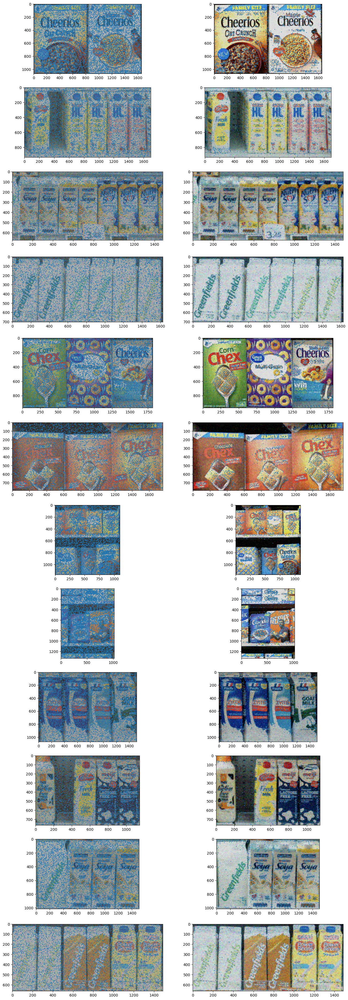

In [5]:
testFilter(filter1, median_size=9, gaussian_sigma=1)

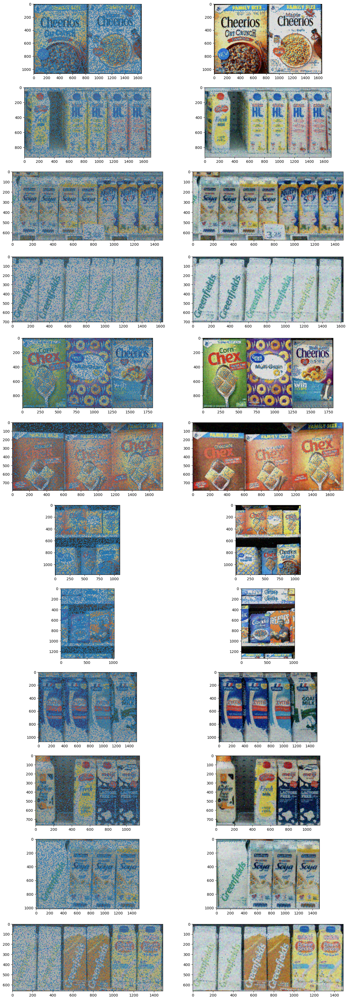

In [6]:
testFilter(filter2, median_size=9)

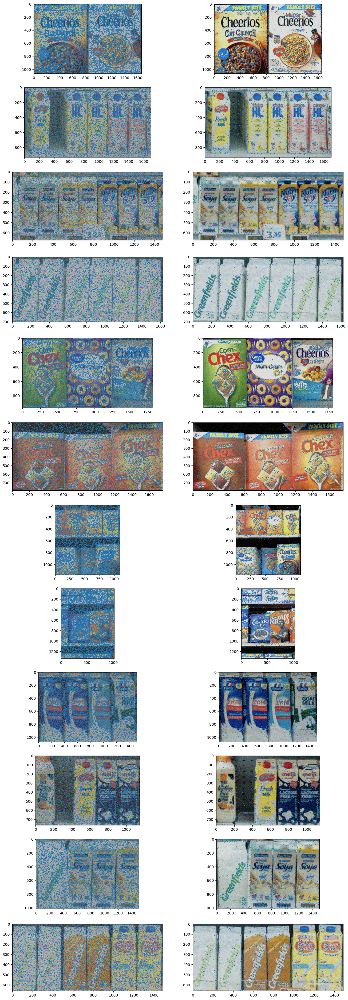

In [7]:
testFilter(filter3, median_size=9)